In [ ]:
import numpy as np
import torch

In [ ]:
gt_sdf = torch.from_numpy(np.load('gt.npy'))
pred_sdf = torch.from_numpy(np.load('pred.npy'))






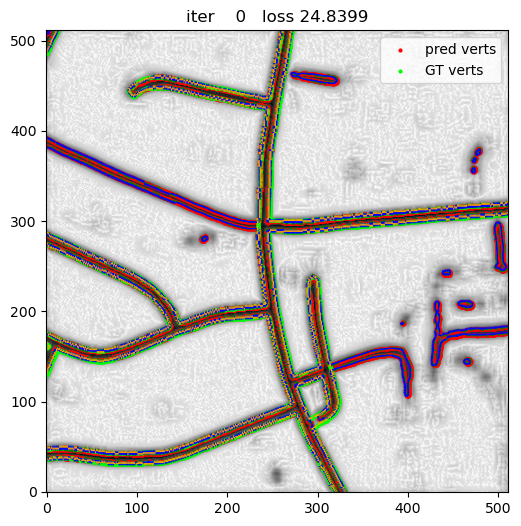

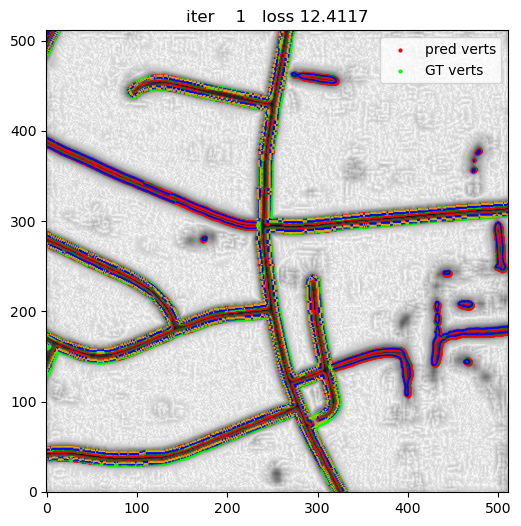

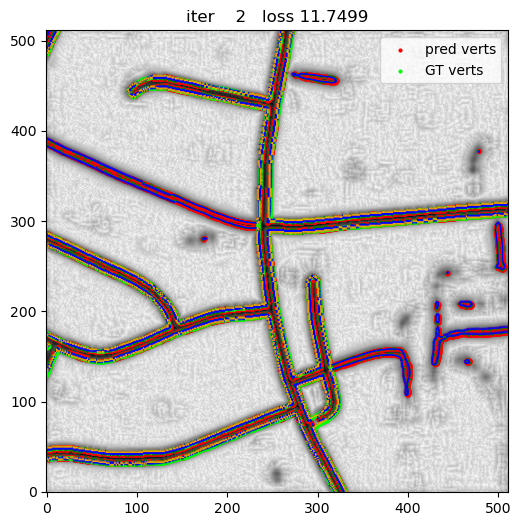

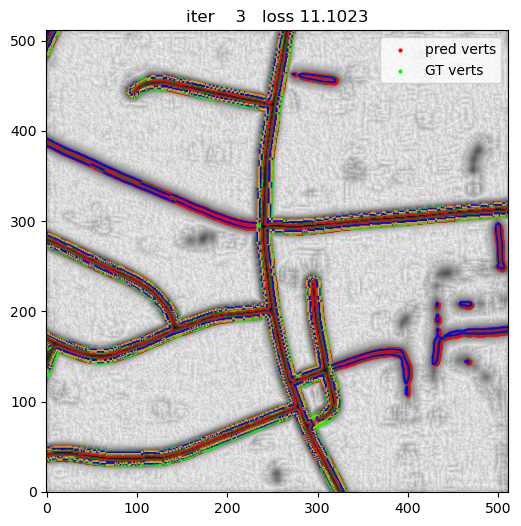

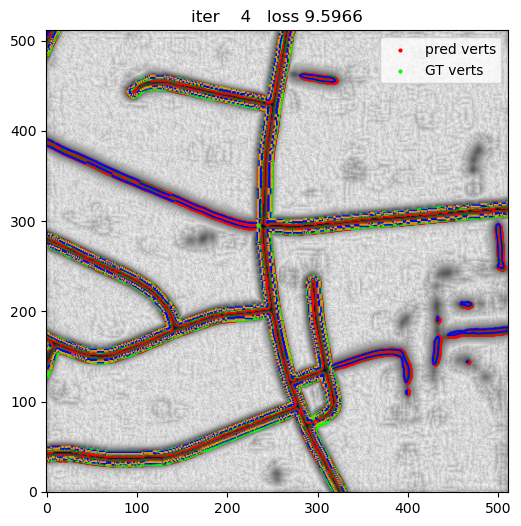

...

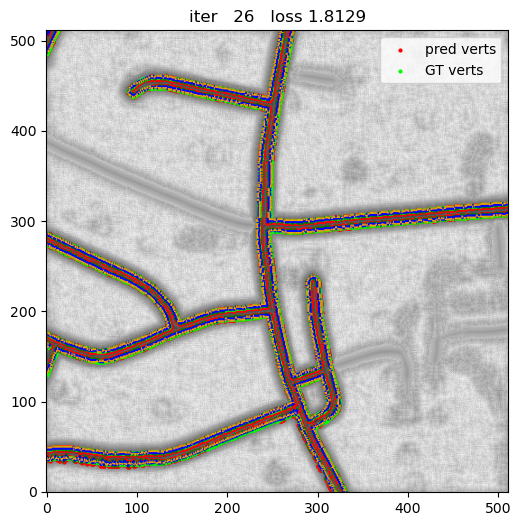

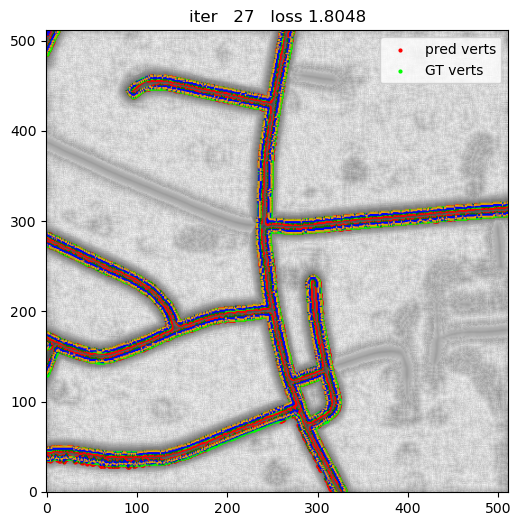

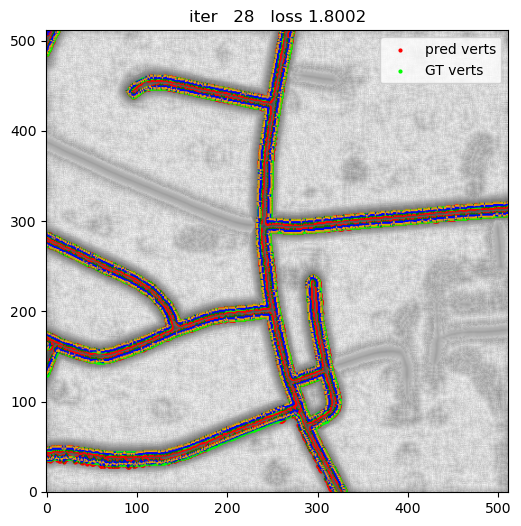

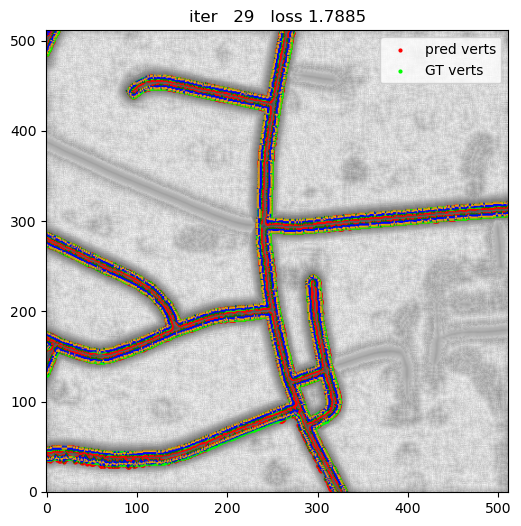

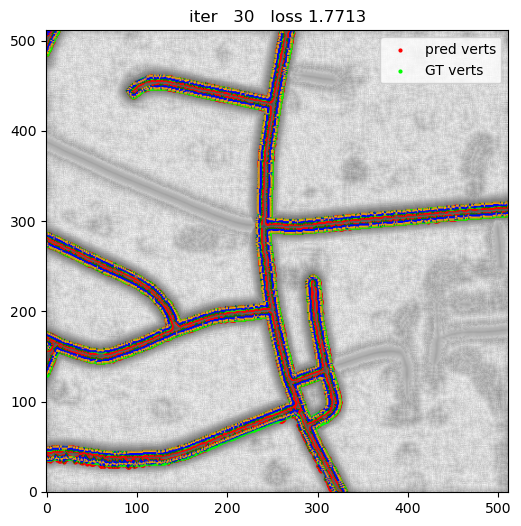

/tmp/ipykernel_165518/1067869844.py:189: RuntimeWarning: invalid value encountered in divide
  v = pnt - tgt; back.append(v/np.linalg.norm(v))


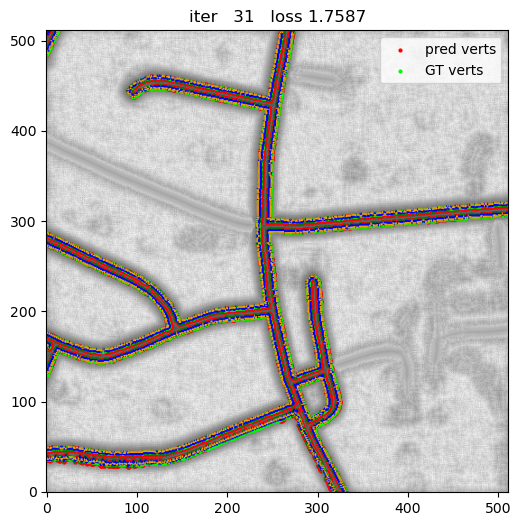

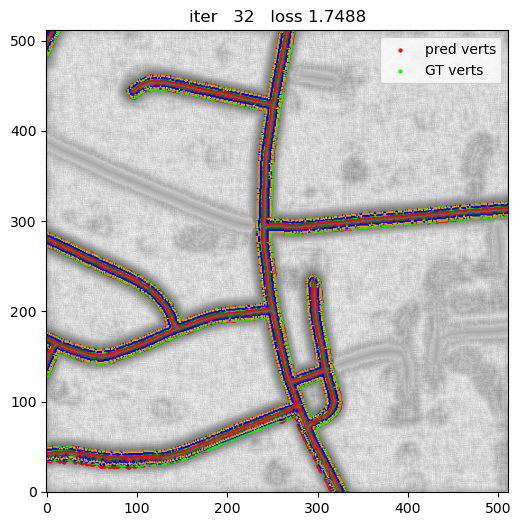

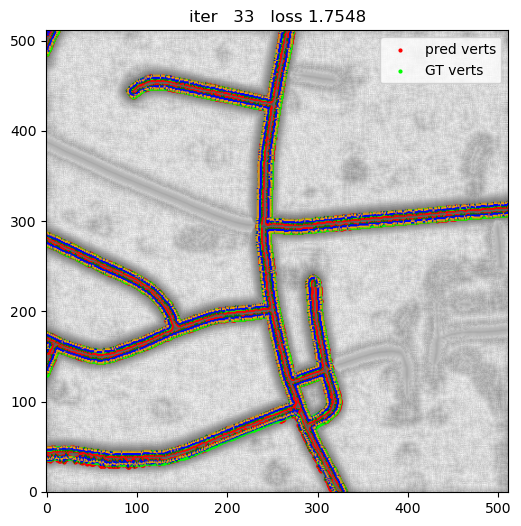

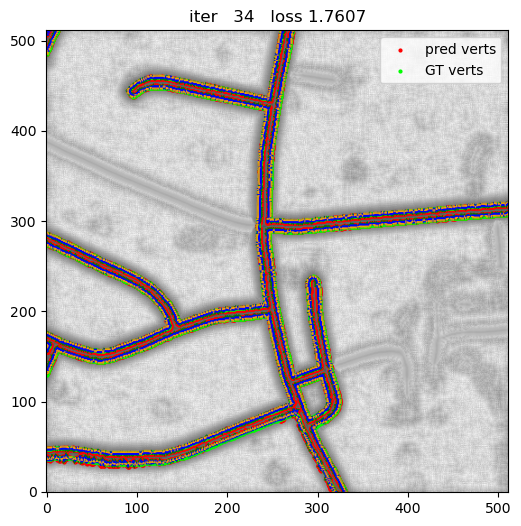

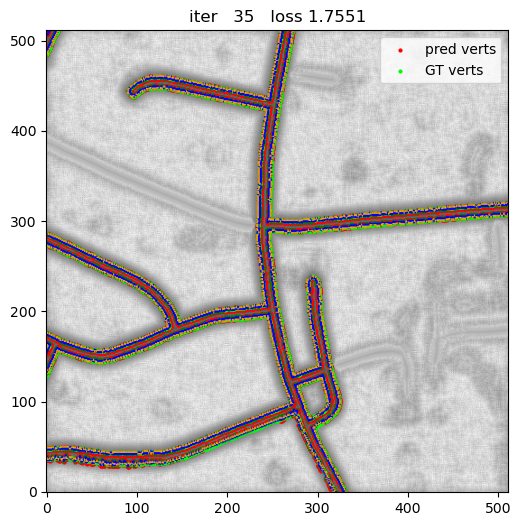

...

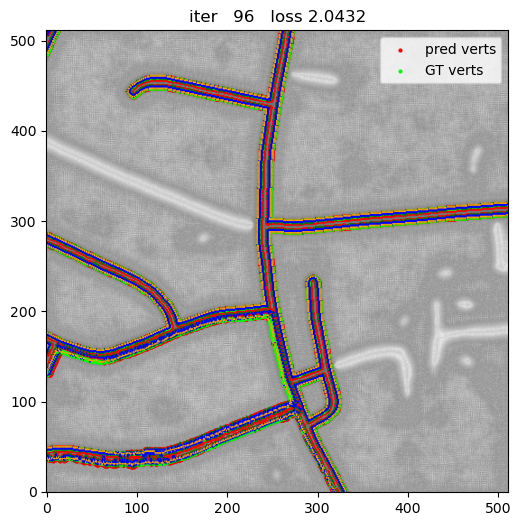

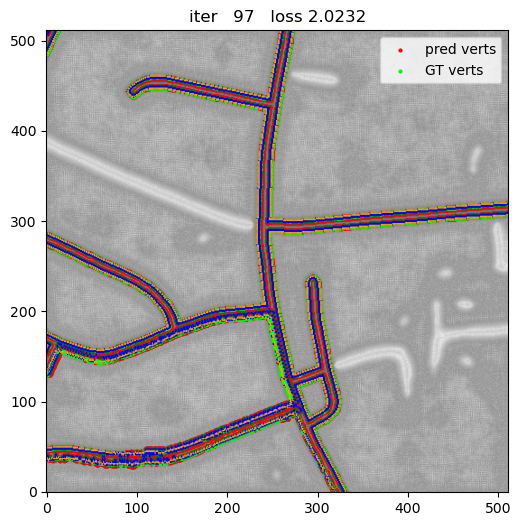

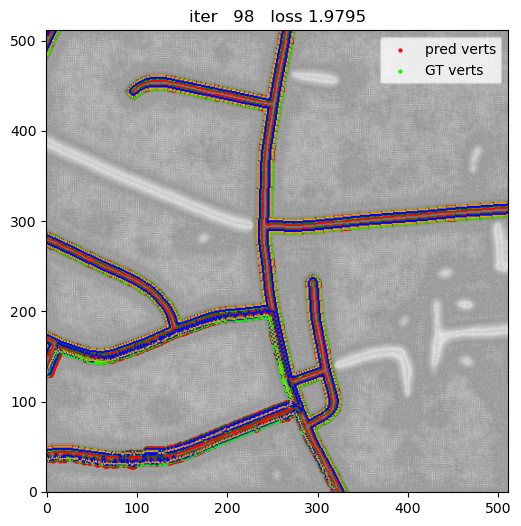

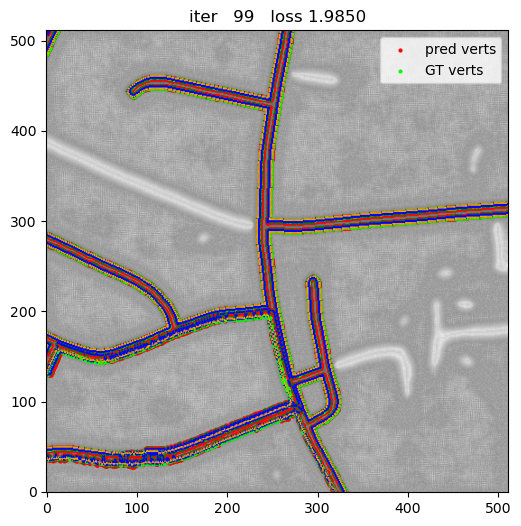

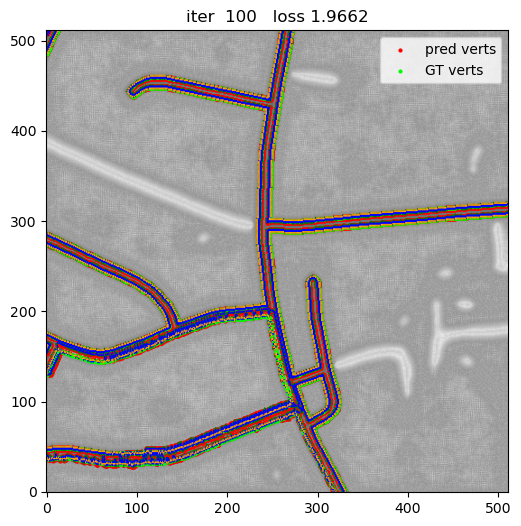

In [1]:
#!/usr/bin/env python3
"""
Full Jupyter‑friendly MeshSDF demo that plots **every** iteration inline.
Just paste this into a single notebook cell and run.
"""

import torch
import torch.nn.functional as F
from skimage import measure
from scipy.ndimage import distance_transform_edt as edt
import matplotlib.pyplot as plt
import numpy as np

# -----------------------------------------------------------------------------
# Settings
# -----------------------------------------------------------------------------
STEPS      = 100
LR         = 5e-1
EIK_WEIGHT = 0.05
OCC_WEIGHT = 2.0
DEVICE     = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# -----------------------------------------------------------------------------
# Utilities
# -----------------------------------------------------------------------------
def mask_to_sdf(mask: torch.Tensor) -> torch.Tensor:
    a = mask.cpu().numpy().astype(np.uint8)
    return torch.from_numpy(edt(1 - a) - edt(a)).float()

def interp_bilinear(img: torch.Tensor, ys: torch.Tensor, xs: torch.Tensor) -> torch.Tensor:
    H, W = img.shape
    y0 = ys.floor().long().clamp(0, H - 2)
    x0 = xs.floor().long().clamp(0, W - 2)
    y1, x1 = y0 + 1, x0 + 1
    wy1, wx1 = ys - y0.float(), xs - x0.float()
    wy0, wx0 = 1 - wy1, 1 - wx1
    return (
        img[y0, x0] * (wy0*wx0) +
        img[y0, x1] * (wy0*wx1) +
        img[y1, x0] * (wy1*wx0) +
        img[y1, x1] * (wy1*wx1)
    )

# -----------------------------------------------------------------------------
# Differentiable marching squares core
# -----------------------------------------------------------------------------
class IsoCurve2D(torch.autograd.Function):
    @staticmethod
    def forward(ctx, sdf):
        b, _, H, W = sdf.shape
        verts_out, meta = [], []
        cpu = sdf.detach().cpu().numpy()
        for i in range(b):
            vb, ib, off = [], [], 0
            for cont in measure.find_contours(cpu[i,0], 0.0):
                pts = torch.from_numpy(cont).float().to(sdf.device)
                y, x = pts[:,0], pts[:,1]
                K = len(pts)
                ib.append((y, x, off, off+K))
                vb.append(torch.stack([x, y],1))
                off += K
            verts_out.append(torch.cat(vb,0) if vb else torch.empty(0,2,device=sdf.device))
            meta.append(ib)
        ctx.save_for_backward(sdf)
        ctx.meta = meta
        return tuple(verts_out)

    @staticmethod
    def backward(ctx, grad_vs):
        sdf, = ctx.saved_tensors
        b,_,H,W = sdf.shape
        grad_sdf = torch.zeros_like(sdf)
        p = F.pad(sdf,(1,1,1,1),mode='replicate')
        dx = 0.5*(p[...,1:-1,2:]-p[...,1:-1,:-2])
        dy = 0.5*(p[...,2:,1:-1]-p[...,:-2,1:-1])
        for i, ib in enumerate(ctx.meta):
            gv = grad_vs[i]
            if gv is None: continue
            for y,x,s,e in ib:
                gseg = gv[s:e]
                if gseg.numel()==0: continue
                dx_v = interp_bilinear(dx[i,0], y, x)
                dy_v = interp_bilinear(dy[i,0], y, x)
                normals = F.normalize(torch.stack([dx_v,dy_v],1), dim=1, eps=1e-6)
                scal = -(gseg*normals).sum(1)
                y0 = y.floor().long().clamp(0,H-2); x0 = x.floor().long().clamp(0,W-2)
                y1, x1 = y0+1, x0+1
                wy1, wx1 = y-y0.float(), x-x0.float()
                wy0, wx0 = 1-wy1, 1-wx1
                for (rr,cc,ww) in [
                        (y0,x0,wy0*wx0), (y0,x1,wy0*wx1),
                        (y1,x0,wy1*wx0), (y1,x1,wy1*wx1)
                    ]:
                    grad_sdf[i,0].index_put_((rr,cc), scal*ww, accumulate=True)
        return (grad_sdf,)

def extract_curve(sdf):
    return IsoCurve2D.apply(sdf)

# -----------------------------------------------------------------------------
# Loss: Chamfer + occupancy + eikonal
# -----------------------------------------------------------------------------
class ShapeLoss(torch.nn.Module):
    def forward(self, pred_sdf, gt_sdf):
        p_v, = extract_curve(pred_sdf)
        g_v, = extract_curve(gt_sdf)
        cham = 0.0
        if p_v.numel() and g_v.numel():
            D = torch.cdist(p_v, g_v)
            cham = D.min(1).values.mean() + D.min(0).values.mean()
        inside   = torch.sigmoid(-gt_sdf/1.5)
        soft_out = F.softplus(pred_sdf, beta=1.0, threshold=10.0)
        soft_in  = F.softplus(-pred_sdf, beta=1.0, threshold=10.0)
        occ = (soft_out*inside).mean() + (soft_in*(1-inside)).mean()
        p = F.pad(pred_sdf,(1,1,1,1),mode='replicate')
        gx = 0.5*(p[...,1:-1,2:]-p[...,1:-1,:-2])
        gy = 0.5*(p[...,2:,1:-1]-p[...,:-2,1:-1])
        eik = (gx.square()+gy.square()).sqrt().sub(1).abs().mean()
        return cham + OCC_WEIGHT*occ + EIK_WEIGHT*eik

# -----------------------------------------------------------------------------
# Prepare GT + pred SDFs
# -----------------------------------------------------------------------------
H, W = 64, 64
gt_mask   = torch.zeros(H, W)
gt_mask[H//2-8:H//2+8, :] = 1
pred_mask = gt_mask.clone()
pred_mask[:, W//2-3:W//2+3] = 0

gt_sdf   = mask_to_sdf(gt_mask)[None,None].to(DEVICE)
pred_sdf = torch.nn.Parameter(mask_to_sdf(pred_mask)[None,None].to(DEVICE))

gt_sdf = torch.from_numpy(np.load('gt.npy')).unsqueeze(0).unsqueeze(0)
pred_sdf = torch.nn.Parameter(torch.from_numpy(np.load('pred.npy')).unsqueeze(0).unsqueeze(0))


loss_fn = ShapeLoss().to(DEVICE)
optim    = torch.optim.Adam([pred_sdf], lr=LR)

# -----------------------------------------------------------------------------
# Main loop: plot every iteration inline
# -----------------------------------------------------------------------------
for it in range(STEPS+1):
    # --- Optimization step ---
    optim.zero_grad()
    loss = loss_fn(pred_sdf, gt_sdf)
    loss.backward()
    optim.step()
    # Renormalize SDF gradients
    with torch.no_grad():
        p = F.pad(pred_sdf,(1,1,1,1),mode='replicate')
        gx = 0.5*(p[...,1:-1,2:]-p[...,1:-1,:-2])
        gy = 0.5*(p[...,2:,1:-1]-p[...,:-2,1:-1])
        pred_sdf.div_((gx.square()+gy.square()).sqrt().mean().clamp(min=1e-6))

    # --- Extract curves + normals + Chamfer arrows ---
    p_v, = extract_curve(pred_sdf)
    g_v, = extract_curve(gt_sdf)
    p_np = p_v.detach().cpu().numpy()
    g_np = g_v.detach().cpu().numpy()

    # compute normals at pred points
    dx = 0.5*(F.pad(pred_sdf,(1,1,1,1),mode='replicate')[...,1:-1,2:] -
              F.pad(pred_sdf,(1,1,1,1),mode='replicate')[...,1:-1,:-2])[0,0].cpu()
    dy = 0.5*(F.pad(pred_sdf,(1,1,1,1),mode='replicate')[...,2:,1:-1] -
              F.pad(pred_sdf,(1,1,1,1),mode='replicate')[...,:-2,1:-1])[0,0].cpu()
    normals = []
    for idx in range(len(p_np)):
        y, x = p_v[idx,0], p_v[idx,1]
        gx_v = interp_bilinear(dx, torch.tensor([y]), torch.tensor([x]))[0]
        gy_v = interp_bilinear(dy, torch.tensor([y]), torch.tensor([x]))[0]
        n = np.array([gx_v.item(), gy_v.item()])
        normals.append(n/np.linalg.norm(n))
    normals = np.stack(normals) if normals else np.empty((0,2))

    # chamfer arrow directions
    if p_np.size and g_np.size:
        fwd, back = [], []
        for pnt in p_np:
            tgt = g_np[np.argmin(np.linalg.norm(g_np - pnt, axis=1))]
            v = tgt - pnt
            norm = np.linalg.norm(v)
            if norm > 1e-8:
                fwd.append(v / norm)
            else:
                fwd.append(np.array([0.0, 0.0]))
        for tgt in g_np:
            pnt = p_np[np.argmin(np.linalg.norm(p_np - tgt, axis=1))]
            v = pnt - tgt; back.append(v/np.linalg.norm(v))
        fwd  = np.stack(fwd); back = np.stack(back)
    else:
        fwd = back = np.empty((0,2))

    # --- Plot a new figure this iteration ---
    plt.figure(figsize=(6,6))
    plt.imshow(pred_sdf.detach().cpu()[0,0], cmap='gray', origin='lower')
    plt.scatter(p_np[:,0], p_np[:,1], c='red',   s=4, label='pred verts')
    plt.scatter(g_np[:,0], g_np[:,1], c='lime',  s=4, label='GT verts')
    plt.quiver(p_np[:,0], p_np[:,1], normals[:,0], normals[:,1],
               angles='xy', scale_units='xy', scale=1/3.0, width=0.002, color='green')
    plt.quiver(p_np[:,0], p_np[:,1], fwd[:,0],    fwd[:,1],
               angles='xy', scale_units='xy', scale=1/3.0, width=0.002, color='blue')
    plt.quiver(g_np[:,0], g_np[:,1], back[:,0],  back[:,1],
               angles='xy', scale_units='xy', scale=1/3.0, width=0.002, color='orange')
    plt.gca().set_aspect('equal')
    plt.legend(loc='upper right')
    plt.title(f"iter {it:4d}   loss {loss.item():.4f}")
    plt.show()


In [ ]:
gt_sdf = torch.from_numpy(np.load('gt.npy'))
pred_sdf = torch.from_numpy(np.load('pred.npy'))

